In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import pathlib
from sklearn.model_selection import train_test_split
import IPython.display as display
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import glob
import os
import random
import shutil
from shutil import copytree

In [5]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

# Tensorflow

In [15]:
class_names = np.array(['healthy', 'pneumonia', 'covid'])
class_names

batch_size = 32

In [7]:
data_dir = pathlib.Path('./images/train/')

healthy= list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [8]:
print(f'healthy lungs: {len(healthy)} images')
print(f'pneumonia lungs: {len(pneumonia)} images')
print(f'coivd lungs: {len(covid)} images')

healthy lungs: 1965 images
pneumonia lungs: 3723 images
coivd lungs: 199 images


In [10]:
len(healthy) + len(pneumonia) + len(covid)

5887

In [11]:
# Function to move files from train folder to test/val folder

def move_files(list, folder):
    for i in list:
        shutil.move(str(i), f'images/{folder}', copy_function=shutil.copy2)
    return 'Complete' 

In [13]:
# creating test subset
healthy_test = random.sample(healthy, int(len(healthy)*.1))
pneumonia_test = random.sample(pneumonia, int(len(pneumonia)*.1))
covid_test = random.sample(covid, int(len(covid)*.1))

move_files(healthy_test, 'test/healthy')
move_files(pneumonia_test, folder = 'test/pneumonia')
move_files(covid_test, folder = 'test/covid')

'Complete'

In [14]:
# updating list of train images
data_dir = pathlib.Path('./images/train/')

healthy = list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [15]:
# creating val subset
healthy_val = random.sample(healthy, len(healthy_test))
pneumonia_val = random.sample(pneumonia, len(pneumonia_test))
covid_val = random.sample(covid, len(covid_test))

move_files(healthy_val, 'validation/healthy')
move_files(pneumonia_val, 'validation/pneumonia')
move_files(covid_val, 'validation/covid')

'Complete'

In [16]:
# train, val, test
data_dir_train = pathlib.Path('./images/train/')
data_dir_val = pathlib.Path('./images/validation/')
data_dir_test = pathlib.Path('./images/test/')

list_train = tf.data.Dataset.list_files(str(data_dir_train/'*/*'))
list_val = tf.data.Dataset.list_files(str(data_dir_val/'*/*'))
list_test = tf.data.Dataset.list_files(str(data_dir_test/'*/*'))

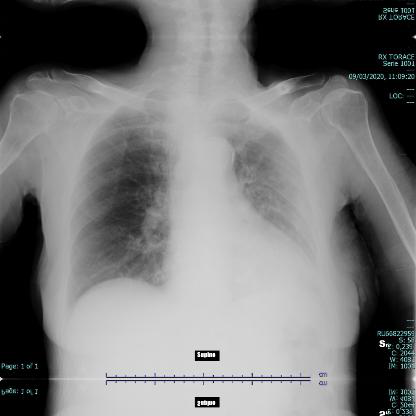

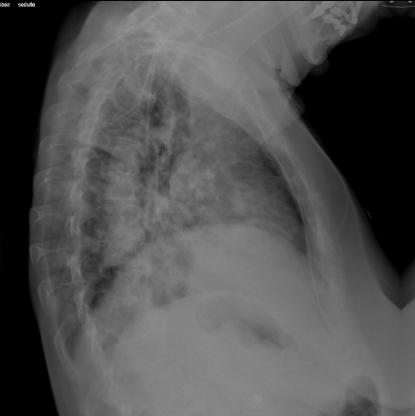

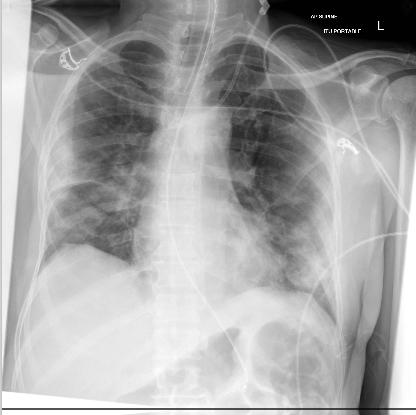

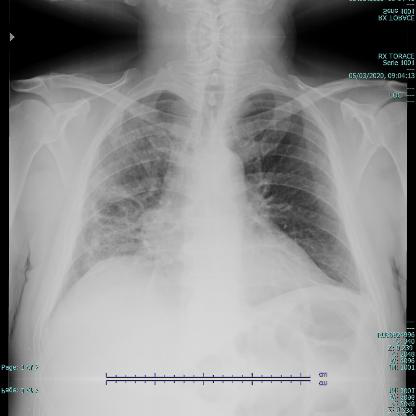

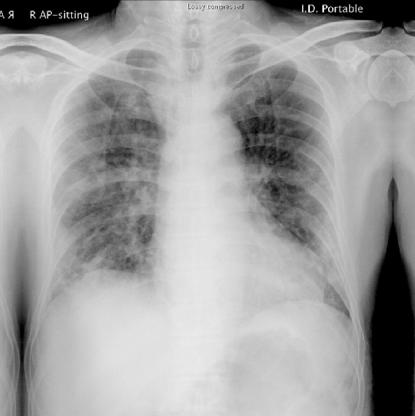

...

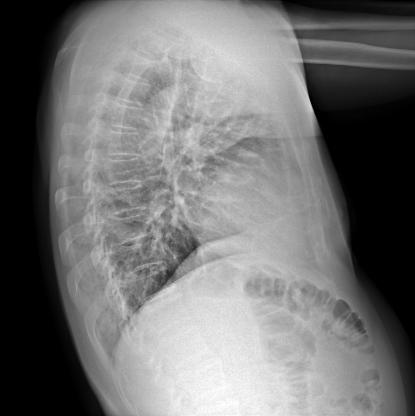

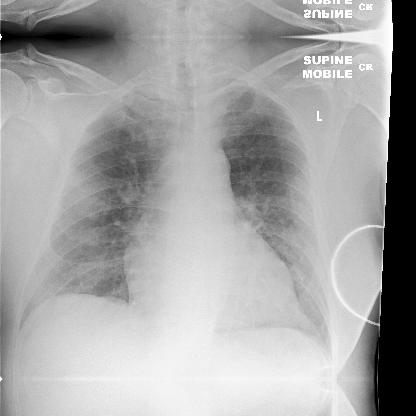

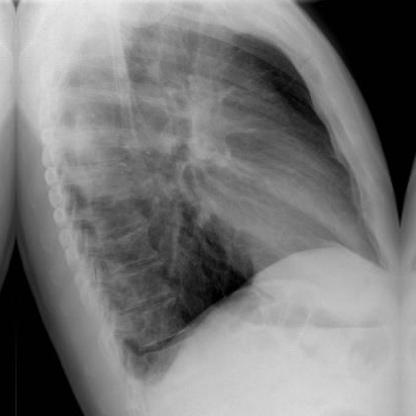

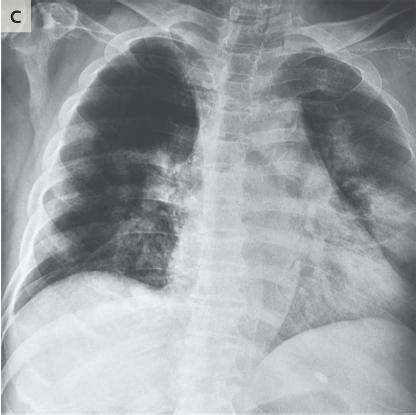

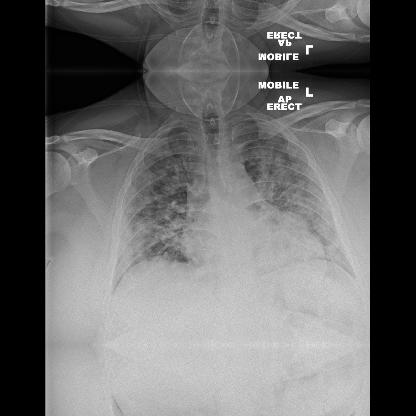

In [17]:
# Check images
for image_path in list(data_dir_train.glob('*covid/*')):
    display.display(Image.open(str(image_path)))

In [18]:
h = len(list(data_dir_train.glob('*healthy/*.jpg'))) + len(list(data_dir_train.glob('*pneumonia/*.jpg')))  + len(list(data_dir_train.glob('*covid/*.jpg')))
v = len(list(data_dir_val.glob('*healthy/*.jpg'))) + len(list(data_dir_val.glob('*pneumonia/*.jpg')))  + len(list(data_dir_val.glob('*covid/*.jpg')))
t = len(list(data_dir_test.glob('*healthy/*.jpg'))) + len(list(data_dir_test.glob('*pneumonia/*.jpg')))  + len(list(data_dir_test.glob('*covid/*.jpg')))

print(f'train dataset: {h} images')
print(f'validation dataset: {v} images')
print(f'test dataset: {t} images')

train dataset: 4713 images
validation dataset: 587 images
test dataset: 587 images


In [19]:
h+v+t

5887

In [20]:
# checking lists for train, val, and test
for f in list_train.take(2):
  print(f.numpy())

for f in list_val.take(2):
  print(f.numpy())

for f in list_test.take(2):
  print(f.numpy())

b'images/train/pneumonia/478d1aa1-98cf-461e-ac56-ec895a241ce0_jpg.rf.b94b86deb43d2113d8945bc818e49d69.jpg'
b'images/train/healthy/bfe24f55-140f-4a6a-a8ed-d0a188316c03_jpg.rf.ccba1f3860b5029bf950d4949b5fa443.jpg'
b'images/validation/pneumonia/4412fc95-4db8-4aa0-a20e-33088eff5032_jpg.rf.b0d52cb4c78f1cead738d8ef62eba11b.jpg'
b'images/validation/covid/covid-19-pneumonia-43-day0_jpeg.rf.962efb1be3ca60562ec70e92b1164a83.jpg'
b'images/test/pneumonia/340244af-50e9-405f-85af-7fe6c8e0f838_jpg.rf.92da95bd5a1522a1358246cf66cfe551.jpg'
b'images/test/pneumonia/c720d329-5d27-4900-a028-60ee274c4a78_jpg.rf.00b07bd172ce69831e6a4c3fb5d0853d.jpg'


In [11]:
def get_label(file_path):
  # convert the path to a list of path components
  parts = tf.strings.split(file_path, os.path.sep)
  # The second to last is the class-directory
  return parts[-2] == class_names

In [26]:
def decode_img(img, IMG):
    # convert the compressed string to a 3D uint8 tensor
    img = tf.image.decode_jpeg(img, channels=3)
    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    # img = (img/127.5) - 1   
    img = tf.image.convert_image_dtype(img, tf.float32)
    # resize the image to the desired size.
    return tf.image.resize(img, [IMG_WIDTH, IMG_HEIGHT])

In [27]:
def process_path(file_path, IMG):
    label = get_label(file_path)
    # load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = decode_img(img, IMG_WIDTH, IMG_HEIGHT)
    return img, label

In [30]:
# Set `num_parallel_calls` so multiple images are loaded/processed in parallel.

IMG_WIDTH = 160
IMG_HEIGHT = 160

labeled_train = list_train.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_test = list_test.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_val = list_val.map(process_path, num_parallel_calls=AUTOTUNE)

In [31]:
for image, label in labeled_train.take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [32]:
for image_test, label_test in labeled_test.take(1):
  print("Image shape: ", image_test.numpy().shape)
  print("Label: ", label_test.numpy())

Image shape:  (160, 160, 3)
Label:  [ True False False]


In [33]:
for image_val, label_val in labeled_val.take(1):
  print("Image shape: ", image_val.numpy().shape)
  print("Label: ", label_val.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [38]:
def prepare_for_training(ds, cache=True, shuffle_buffer_size=1000):

  if cache:
    if isinstance(cache, str):
      ds = ds.cache(cache)
    else:
      ds = ds.cache()

  ds = ds.shuffle(buffer_size=shuffle_buffer_size)

  # Repeat forever
  ds = ds.repeat()

  ds = ds.batch(batch_size)

  # `prefetch` lets the dataset fetch batches in the background while the model
  # is training.
  ds = ds.prefetch(buffer_size=AUTOTUNE)

  return ds

In [41]:
train_ds = prepare_for_training(labeled_train)
image_batch_train, label_batch_train = next(iter(train_ds))

val_ds = prepare_for_training(labeled_val)
image_batch_val, label_batch_val = next(iter(val_ds))

test_ds = prepare_for_training(labeled_test)
image_batch_test, label_batch_test = next(iter(test_ds))

In [49]:
def show_batch(image_batch, label_batch):
  plt.figure(figsize=(10,10))
  for n in range(25):
      ax = plt.subplot(5,5,n+1)
      plt.imshow(image_batch[n])
      plt.title(class_names[label_batch[n]==1][0].title())
      plt.axis('off')

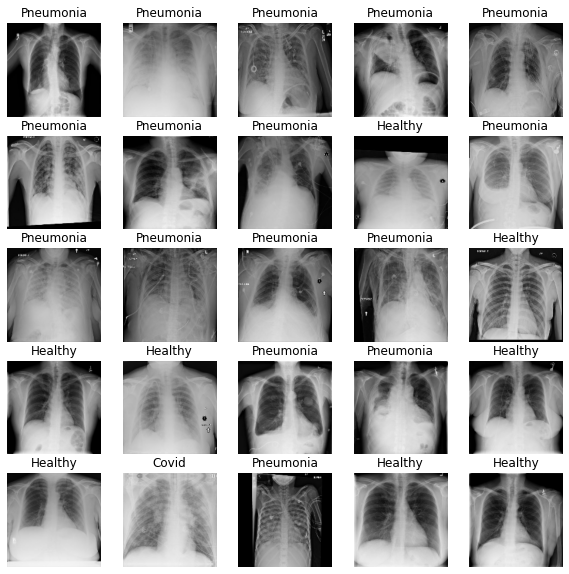

In [50]:
show_batch(image_batch_train.numpy(), label_batch_train.numpy())

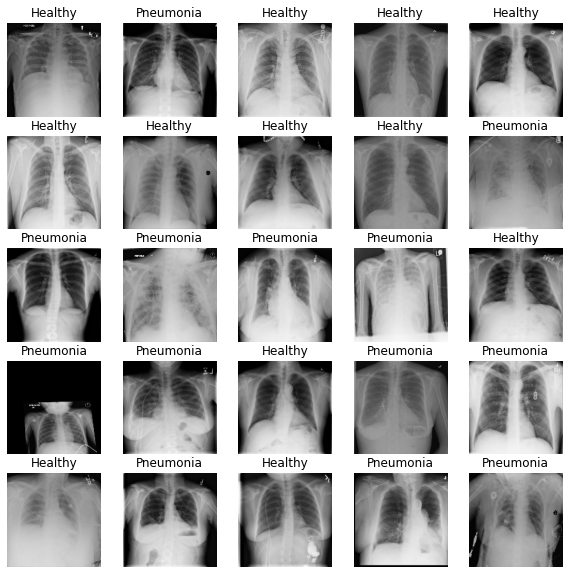

In [51]:
show_batch(image_batch_val.numpy(), label_batch_val.numpy())

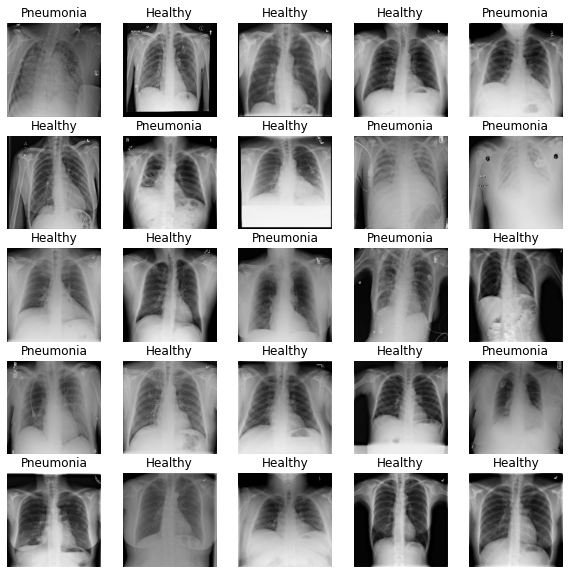

In [52]:
show_batch(image_batch_test.numpy(), label_batch_test.numpy())

In [53]:
for image_batch, label_batch in train_ds.take(1):
   pass

image_batch.shape

TensorShape([32, 160, 160, 3])

In [633]:
# Model

In [54]:
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [55]:
# Feature Extraction
# Freeze the convolutional base
base_model.trainable = False

In [56]:
base_model.summary()

Model: "mobilenetv2_1.00_160"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 161, 161, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 80, 80, 32)   864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 80, 80, 32)   128         Conv1[0][0]                      
_______________________________________________________________________________

In [58]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 5, 5, 1280)


In [59]:
# Classification head
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [60]:
# single prediction per image 
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [61]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [62]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [63]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_160 (Model) (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 3,843
Non-trainable params: 2,257,984
_________________________________________________________________


In [64]:
len(model.trainable_variables)

2

In [65]:
initial_epochs = 10
validation_steps = 20

loss0,accuracy0 = model.evaluate(val_ds, steps = validation_steps)

20/20 [==============================] - 12s 588ms/step - loss: 1.7034 - accuracy: 0.3328


In [66]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 1.70
initial accuracy: 0.33


In [67]:
image_count = len(list(data_dir_train.glob('*/*.jpg')))
image_count_v = len(list(data_dir_val.glob('*/*.jpg')))

In [69]:
step = np.ceil(image_count/batch_size)
v_step = np.ceil(image_count_v/batch_size)

history_tf = model.fit(train_ds,
                       epochs=initial_epochs,
                       steps_per_epoch = step,
                       validation_data=val_ds,
                       validation_steps = v_step)

Epoch 1/10
148/148 [==============================] - 164s 1s/step - loss: 0.9036 - accuracy: 0.5534 - val_loss: 0.7013 - val_accuracy: 0.6546
Epoch 2/10
148/148 [==============================] - 130s 878ms/step - loss: 0.6473 - accuracy: 0.7116 - val_loss: 0.5884 - val_accuracy: 0.7500
Epoch 3/10
148/148 [==============================] - 129s 869ms/step - loss: 0.5699 - accuracy: 0.7546 - val_loss: 0.5510 - val_accuracy: 0.7862
Epoch 4/10
148/148 [==============================] - 129s 870ms/step - loss: 0.5290 - accuracy: 0.7770 - val_loss: 0.5170 - val_accuracy: 0.7977
Epoch 5/10
148/148 [==============================] - 111s 749ms/step - loss: 0.5055 - accuracy: 0.7855 - val_loss: 0.4961 - val_accuracy: 0.8010
Epoch 6/10
148/148 [==============================] - 110s 744ms/step - loss: 0.4843 - accuracy: 0.7948 - val_loss: 0.4957 - val_accuracy: 0.8010
Epoch 7/10
148/148 [==============================] - 103s 693ms/step - loss: 0.4654 - accuracy: 0.8019 - val_loss: 0.4818 - va

In [95]:
model.save('first_model')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: first_model/assets


In [100]:
# dir(history_tf)
history_tf.history['']

{'loss': [0.903573751449585,
  0.6473314762115479,
  0.5698755383491516,
  0.5289804935455322,
  0.5054782629013062,
  0.48428720235824585,
  0.4654189944267273,
  0.46275776624679565,
  0.4494975805282593,
  0.4400956332683563,
  1.1501760482788086,
  0.49127817153930664,
  0.4181535840034485,
  0.3641276955604553,
  0.323263019323349,
  0.28832387924194336,
  0.25538530945777893,
  0.22880275547504425,
  0.19815951585769653,
  0.18145661056041718,
  0.16425223648548126],
 'accuracy': [0.5534206032752991,
  0.7115709185600281,
  0.7546452879905701,
  0.7770270109176636,
  0.7854729890823364,
  0.7947635054588318,
  0.8019425868988037,
  0.8013091087341309,
  0.8135557174682617,
  0.8169341087341309,
  0.5198479890823364,
  0.8067989945411682,
  0.8291807174682617,
  0.8513513803482056,
  0.8701435923576355,
  0.8874577879905701,
  0.9077280163764954,
  0.9165962934494019,
  0.9336993098258972,
  0.9410895109176636,
  0.9529138803482056],
 'val_loss': [0.7013019323348999,
  0.588379919

In [70]:
np.argmax(model.predict(test_ds, steps = 1), axis=-1) # change steps to number of batches

array([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 0, 1, 1, 1, 1, 0])

In [71]:
len(np.argmax(model.predict(test_ds, steps = 1), axis=-1))

32

In [72]:
dir(test_ds)

['_GeneratorState',
 '__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_add_variable_with_custom_getter',
 '_apply_options',
 '_as_serialized_graph',
 '_buffer_size',
 '_checkpoint_dependencies',
 '_consumers',
 '_deferred_dependencies',
 '_flat_shapes',
 '_flat_structure',
 '_flat_types',
 '_functions',
 '_gather_saveables_for_checkpoint',
 '_graph',
 '_graph_attr',
 '_handle_deferred_dependencies',
 '_has_captured_ref',
 '_input_dataset',
 '_inputs',
 '_list_extra_dependencies_for_serialization',
 '_list_functions_for_serialization',
 '_lookup_dependency',
 '_maybe_initialize_trackable',
 '_name_based_attribute_restore

In [73]:
y = []
counter = 0
for a, b in test_ds:
    if counter == int(/32)
    for i in b:
        y.append(np.argmax(i))
print(y)

SyntaxError: invalid syntax (<ipython-input-73-e35154b0f8c9>, line 4)

In [74]:
model.get_weights()

[array([[[[ 7.51734003e-02,  2.11393330e-02, -8.61470163e-01,
            1.35980397e-01,  9.89127811e-03,  1.42140016e-01,
            6.25003934e-01,  1.50594607e-01,  2.05895714e-02,
            2.81278112e-22, -1.14358437e-21, -2.27494485e-22,
           -3.27495903e-01, -9.08321049e-03,  1.29852386e-03,
            1.84906259e-01,  1.51867405e-01, -1.76067978e-01,
           -1.50455639e-01,  2.06756033e-02,  5.94916864e-23,
            1.41179981e-03,  6.17588401e-01,  3.74927633e-02,
            1.79815572e-02,  2.04572105e-03,  1.29552171e-01,
            6.81161929e-22,  3.64851556e-03, -4.71202396e-02,
           -5.23118713e-21,  3.10034745e-21],
          [ 3.49049985e-01, -6.10829890e-02,  5.23225546e-01,
            2.45421678e-01,  2.46485951e-03, -1.03372492e-01,
            1.03341877e+00,  3.13968539e-01,  1.83513258e-02,
            3.37590639e-22, -1.15860822e-21,  2.21702453e-22,
           -9.38358679e-02, -7.35998899e-02,  3.62410322e-02,
            2.31308311e-

In [699]:
dir(labeled_test)

['_GeneratorState',
 '__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_add_variable_with_custom_getter',
 '_apply_options',
 '_as_serialized_graph',
 '_checkpoint_dependencies',
 '_consumers',
 '_deferred_dependencies',
 '_deterministic',
 '_flat_shapes',
 '_flat_structure',
 '_flat_types',
 '_functions',
 '_gather_saveables_for_checkpoint',
 '_graph',
 '_graph_attr',
 '_handle_deferred_dependencies',
 '_has_captured_ref',
 '_input_dataset',
 '_inputs',
 '_list_extra_dependencies_for_serialization',
 '_list_functions_for_serialization',
 '_lookup_dependency',
 '_map_func',
 '_maybe_initialize_trackable',
 '_name_based_a

In [75]:
np.argmax(model.(test_ds, steps = 1), axis=-1) # change steps to number of batches

SyntaxError: invalid syntax (<ipython-input-75-84899cd22dec>, line 1)

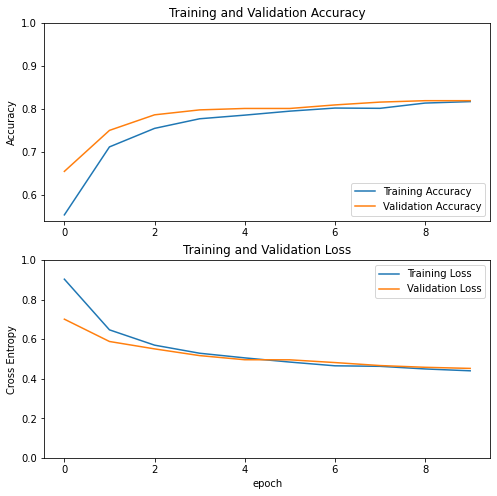

In [78]:
acc = history_tf.history['accuracy']
val_acc = history_tf.history['val_accuracy']

loss = history_tf.history['loss']
val_loss = history_tf.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [79]:
base_model.trainable = True

In [80]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  155


In [81]:
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [82]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_160 (Model) (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 1,866,435
Non-trainable params: 395,392
_________________________________________________________________


In [83]:
len(model.trainable_variables)

58

In [84]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine_tf = model.fit(train_ds,
                            epochs=total_epochs,
                            steps_per_epoch = step,
                            initial_epoch =  history_tf.epoch[-1],
                            validation_data=val_ds,
                            validation_steps = v_step)

Epoch 10/20
148/148 [==============================] - 171s 1s/step - loss: 1.1502 - accuracy: 0.5198 - val_loss: 0.7210 - val_accuracy: 0.7188
Epoch 11/20
148/148 [==============================] - 162s 1s/step - loss: 0.4913 - accuracy: 0.8068 - val_loss: 0.6220 - val_accuracy: 0.7599
Epoch 12/20
148/148 [==============================] - 162s 1s/step - loss: 0.4182 - accuracy: 0.8292 - val_loss: 0.5408 - val_accuracy: 0.8141
Epoch 13/20
148/148 [==============================] - 181s 1s/step - loss: 0.3641 - accuracy: 0.8514 - val_loss: 0.4933 - val_accuracy: 0.8289
Epoch 14/20
148/148 [==============================] - 165s 1s/step - loss: 0.3233 - accuracy: 0.8701 - val_loss: 0.4589 - val_accuracy: 0.8454
Epoch 15/20
148/148 [==============================] - 202s 1s/step - loss: 0.2883 - accuracy: 0.8875 - val_loss: 0.4255 - val_accuracy: 0.8454
Epoch 16/20
148/148 [==============================] - 225s 2s/step - loss: 0.2554 - accuracy: 0.9077 - val_loss: 0.4093 - val_accuracy:

In [85]:
acc += history_fine_tf.history['accuracy']
val_acc += history_fine_tf.history['val_accuracy']

loss += history_fine_tf.history['loss']
val_loss += history_fine_tf.history['val_loss']

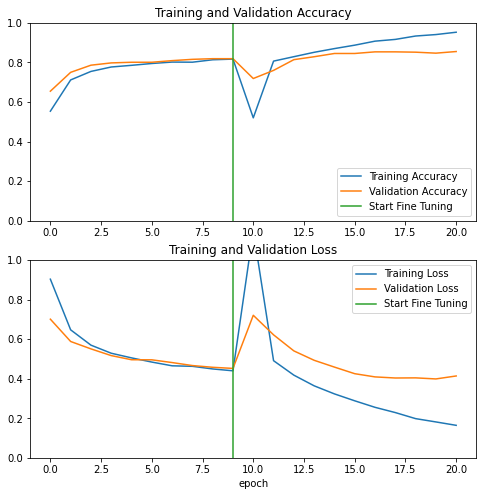

In [86]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# TensorFlow

In [30]:
def image_processing(batch, width, height, initial_epochs_given = 10, validation_steps_given = 20, metric = 'accuracy'):
    
    IMG_WIDTH = width
    IMG_HEIGHT = height
    batch_size = batch

    data_dir_train = pathlib.Path('./images/train/')
    data_dir_val = pathlib.Path('./images/validation/')
    data_dir_test = pathlib.Path('./images/test/')

    list_train = tf.data.Dataset.list_files(str(data_dir_train/'*/*'))
    list_val = tf.data.Dataset.list_files(str(data_dir_val/'*/*'))
    list_test = tf.data.Dataset.list_files(str(data_dir_test/'*/*'))

    labeled_train = list_train.map(process_path, num_parallel_calls=AUTOTUNE)
    labeled_test = list_test.map(process_path, num_parallel_calls=AUTOTUNE)
    labeled_val = list_val.map(process_path, num_parallel_calls=AUTOTUNE)

    train_ds = prepare_for_training(labeled_train)
    val_ds = prepare_for_training(labeled_val)
    test_ds = prepare_for_training(labeled_test)

    IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

    # Create the base model from the pre-trained model MobileNet V2
    base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                                   include_top=False,
                                                   weights='imagenet')

    base_model.trainable = False
    
    for image_batchs, label_batch in train_ds.take(1):
        pass
    
    feature_batch = base_model(image_batchs)

    # Classification head
    global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
    feature_batch_average = global_average_layer(feature_batch)
    print(feature_batch_average.shape)

    # single prediction per image 
    prediction_layer = tf.keras.layers.Dense(3)
    prediction_batch = prediction_layer(feature_batch_average)
    print(prediction_batch.shape)

    model = tf.keras.Sequential([
      base_model,
      global_average_layer,
      prediction_layer
    ])

    base_learning_rate = 0.0001
    model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
                  loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
                  metrics=[metric])

    initial_epochs = initial_epochs_given
    validation_steps = validation_steps_given

    image_count = len(glob.glob('images/train/*/*.jpg'))
    image_count_v = len(glob.glob('images/validation/*/*.jpg'))

    step = np.ceil(image_count/batch_size)
    v_step = np.ceil(image_count_v/batch_size)

    history_tf = model.fit(train_ds,
                           epochs=initial_epochs,
                           steps_per_epoch = step,
                           validation_data=val_ds,
                           validation_steps = v_step
                          )
    
    model.save(f'model_{batch}_{width}_{initial_epochs_given}_{validation_steps_given}_{metric}')
    return history_tf

In [31]:
IMG_WIDTH = 160
IMG_HEIGHT = 160
m = image_processing(batch = 32, width = 160, height = 160, initial_epochs_given = 15, validation_steps_given = 20)

TypeError: in user code:


    TypeError: tf__process_path() missing 1 required positional argument: 'IMG'


In [ ]:
l = []
for b in [32, 64, 128]:
        for size in [160, 225]:
            for epoch in [10, 15]:
                    print(b,t,size,epoch)
                    m = image_processing(batch = b, width = size, height = size, initial_epochs_given = epoch)
                    l.append(m)

(32, 1280)
(32, 3)
Epoch 1/10
148/148 [==============================] - 118s 794ms/step - loss: 0.9810 - accuracy: 0.5152 - val_loss: 0.7062 - val_accuracy: 0.6694
Epoch 2/10
148/148 [==============================] - 107s 724ms/step - loss: 0.6753 - accuracy: 0.6928 - val_loss: 0.5982 - val_accuracy: 0.7467
Epoch 3/10
148/148 [==============================] - 104s 704ms/step - loss: 0.5941 - accuracy: 0.7470 - val_loss: 0.5457 - val_accuracy: 0.7730
Epoch 4/10
148/148 [==============================] - 107s 721ms/step - loss: 0.5434 - accuracy: 0.7709 - val_loss: 0.5092 - val_accuracy: 0.7928
Epoch 5/10
148/148 [==============================] - 103s 698ms/step - loss: 0.5188 - accuracy: 0.7861 - val_loss: 0.5013 - val_accuracy: 0.8010
Epoch 6/10
148/148 [==============================] - 106s 719ms/step - loss: 0.4972 - accuracy: 0.7941 - val_loss: 0.4826 - val_accuracy: 0.8076
Epoch 7/10
148/148 [==============================] - 103s 696ms/step - loss: 0.4811 - accuracy: 0.7973 -

148/148 [==============================] - 124s 839ms/step - loss: 0.8748 - accuracy: 0.5800 - val_loss: 0.7055 - val_accuracy: 0.6941
Epoch 2/10
148/148 [==============================] - 104s 701ms/step - loss: 0.6162 - accuracy: 0.7354 - val_loss: 0.6045 - val_accuracy: 0.7401
Epoch 3/10
148/148 [==============================] - 107s 720ms/step - loss: 0.5516 - accuracy: 0.7639 - val_loss: 0.5702 - val_accuracy: 0.7484
Epoch 4/10
148/148 [==============================] - 102s 691ms/step - loss: 0.5191 - accuracy: 0.7760 - val_loss: 0.5410 - val_accuracy: 0.7681
Epoch 5/10
148/148 [==============================] - 105s 706ms/step - loss: 0.4977 - accuracy: 0.7861 - val_loss: 0.5157 - val_accuracy: 0.7845
Epoch 6/10
148/148 [==============================] - 103s 693ms/step - loss: 0.4788 - accuracy: 0.7939 - val_loss: 0.5138 - val_accuracy: 0.7878
Epoch 7/10
148/148 [==============================] - 104s 703ms/step - loss: 0.4660 - accuracy: 0.7998 - val_loss: 0.4951 - val_accura

148/148 [==============================] - 110s 742ms/step - loss: 0.5747 - accuracy: 0.7530 - val_loss: 0.5382 - val_accuracy: 0.7862
Epoch 3/15
148/148 [==============================] - 102s 690ms/step - loss: 0.5247 - accuracy: 0.7791 - val_loss: 0.5084 - val_accuracy: 0.7911
Epoch 4/15
148/148 [==============================] - 100s 677ms/step - loss: 0.5047 - accuracy: 0.7889 - val_loss: 0.5069 - val_accuracy: 0.7977
Epoch 5/15
148/148 [==============================] - 101s 681ms/step - loss: 0.4831 - accuracy: 0.7975 - val_loss: 0.4746 - val_accuracy: 0.8043
Epoch 6/15
148/148 [==============================] - 100s 675ms/step - loss: 0.4757 - accuracy: 0.8007 - val_loss: 0.4811 - val_accuracy: 0.8026
Epoch 7/15
148/148 [==============================] - 101s 680ms/step - loss: 0.4621 - accuracy: 0.8057 - val_loss: 0.4755 - val_accuracy: 0.7928
Epoch 8/15
148/148 [==============================] - 99s 671ms/step - loss: 0.4579 - accuracy: 0.8100 - val_loss: 0.4676 - val_accurac

148/148 [==============================] - 98s 660ms/step - loss: 0.5329 - accuracy: 0.7842 - val_loss: 0.5325 - val_accuracy: 0.7845
Epoch 5/10
148/148 [==============================] - 101s 682ms/step - loss: 0.5197 - accuracy: 0.7846 - val_loss: 0.5274 - val_accuracy: 0.7763
Epoch 6/10
148/148 [==============================] - 100s 673ms/step - loss: 0.5016 - accuracy: 0.7924 - val_loss: 0.5121 - val_accuracy: 0.7993
Epoch 7/10
148/148 [==============================] - 102s 687ms/step - loss: 0.4845 - accuracy: 0.7986 - val_loss: 0.4953 - val_accuracy: 0.7993
Epoch 8/10
148/148 [==============================] - 102s 687ms/step - loss: 0.4778 - accuracy: 0.7998 - val_loss: 0.4971 - val_accuracy: 0.7862
Epoch 9/10
148/148 [==============================] - 102s 691ms/step - loss: 0.4664 - accuracy: 0.8057 - val_loss: 0.4946 - val_accuracy: 0.7977
Epoch 10/10
148/148 [==============================] - 97s 658ms/step - loss: 0.4603 - accuracy: 0.8070 - val_loss: 0.4761 - val_accurac

74/74 [==============================] - 49s 668ms/step - loss: 0.5411 - accuracy: 0.7753 - val_loss: 0.5050 - val_accuracy: 0.7969
Epoch 5/15
74/74 [==============================] - 49s 667ms/step - loss: 0.5205 - accuracy: 0.7851 - val_loss: 0.5559 - val_accuracy: 0.7719
Epoch 6/15
74/74 [==============================] - 48s 655ms/step - loss: 0.5075 - accuracy: 0.7825 - val_loss: 0.4894 - val_accuracy: 0.7750
Epoch 7/15
74/74 [==============================] - 49s 660ms/step - loss: 0.5036 - accuracy: 0.7842 - val_loss: 0.5069 - val_accuracy: 0.7781
Epoch 8/15
74/74 [==============================] - 52s 700ms/step - loss: 0.4714 - accuracy: 0.8062 - val_loss: 0.4969 - val_accuracy: 0.7937
Epoch 9/15
74/74 [==============================] - 50s 681ms/step - loss: 0.4845 - accuracy: 0.7914 - val_loss: 0.4296 - val_accuracy: 0.8125
Epoch 10/15
74/74 [==============================] - 53s 712ms/step - loss: 0.4591 - accuracy: 0.8087 - val_loss: 0.4807 - val_accuracy: 0.7906
Epoch 11/

74/74 [==============================] - 68s 922ms/step - loss: 0.8746 - accuracy: 0.5617 - val_loss: 0.7287 - val_accuracy: 0.6562
Epoch 2/10
74/74 [==============================] - 51s 693ms/step - loss: 0.6574 - accuracy: 0.7107 - val_loss: 0.6263 - val_accuracy: 0.7125
Epoch 3/10
74/74 [==============================] - 50s 672ms/step - loss: 0.5902 - accuracy: 0.7428 - val_loss: 0.5780 - val_accuracy: 0.7594
Epoch 4/10
74/74 [==============================] - 51s 687ms/step - loss: 0.5637 - accuracy: 0.7660 - val_loss: 0.5620 - val_accuracy: 0.7563
Epoch 5/10
74/74 [==============================] - 51s 696ms/step - loss: 0.5529 - accuracy: 0.7568 - val_loss: 0.5547 - val_accuracy: 0.7469
Epoch 6/10
74/74 [==============================] - 52s 708ms/step - loss: 0.5124 - accuracy: 0.7867 - val_loss: 0.5290 - val_accuracy: 0.7469
Epoch 7/10
74/74 [==============================] - 48s 653ms/step - loss: 0.5104 - accuracy: 0.7804 - val_loss: 0.5032 - val_accuracy: 0.7812
Epoch 8/10

74/74 [==============================] - 67s 908ms/step - loss: 1.1513 - accuracy: 0.4362 - val_loss: 0.8787 - val_accuracy: 0.5281
Epoch 2/15
74/74 [==============================] - 51s 689ms/step - loss: 0.7785 - accuracy: 0.6199 - val_loss: 0.7366 - val_accuracy: 0.6875
Epoch 3/15
74/74 [==============================] - 54s 726ms/step - loss: 0.6675 - accuracy: 0.7103 - val_loss: 0.5806 - val_accuracy: 0.7344
Epoch 4/15
74/74 [==============================] - 50s 677ms/step - loss: 0.6014 - accuracy: 0.7348 - val_loss: 0.6209 - val_accuracy: 0.7281
Epoch 5/15
74/74 [==============================] - 50s 671ms/step - loss: 0.5952 - accuracy: 0.7445 - val_loss: 0.5508 - val_accuracy: 0.7875
Epoch 6/15
74/74 [==============================] - 49s 665ms/step - loss: 0.5459 - accuracy: 0.7568 - val_loss: 0.5483 - val_accuracy: 0.7625
Epoch 7/15
74/74 [==============================] - 53s 716ms/step - loss: 0.5496 - accuracy: 0.7610 - val_loss: 0.5719 - val_accuracy: 0.7688
Epoch 8/15

74/74 [==============================] - 50s 671ms/step - loss: 0.5023 - accuracy: 0.7770 - val_loss: 0.4647 - val_accuracy: 0.8094
Epoch 10/10
74/74 [==============================] - 51s 694ms/step - loss: 0.4860 - accuracy: 0.7952 - val_loss: 0.4356 - val_accuracy: 0.8281
INFO:tensorflow:Assets written to: model_64_225_10_25_accuracy/assets
(32, 1280)
(32, 3)
Epoch 1/15
74/74 [==============================] - 72s 976ms/step - loss: 0.8834 - accuracy: 0.5798 - val_loss: 0.7366 - val_accuracy: 0.6313
Epoch 2/15
74/74 [==============================] - 56s 751ms/step - loss: 0.6695 - accuracy: 0.6959 - val_loss: 0.6145 - val_accuracy: 0.7188
Epoch 3/15
74/74 [==============================] - 54s 727ms/step - loss: 0.6137 - accuracy: 0.7217 - val_loss: 0.5805 - val_accuracy: 0.7500
Epoch 4/15
74/74 [==============================] - 50s 676ms/step - loss: 0.5795 - accuracy: 0.7470 - val_loss: 0.5404 - val_accuracy: 0.7688
Epoch 5/15
74/74 [==============================] - 49s 667ms/s

Epoch 14/15
74/74 [==============================] - 49s 659ms/step - loss: 0.4967 - accuracy: 0.7927 - val_loss: 0.4933 - val_accuracy: 0.8000
Epoch 15/15
74/74 [==============================] - 49s 669ms/step - loss: 0.4510 - accuracy: 0.8104 - val_loss: 0.4986 - val_accuracy: 0.8094
INFO:tensorflow:Assets written to: model_64_225_15_25_accuracy/assets
(32, 1280)
(32, 3)
Epoch 1/10
37/37 [==============================] - 65s 2s/step - loss: 0.9705 - accuracy: 0.5203 - val_loss: 0.8844 - val_accuracy: 0.5688
Epoch 2/10
37/37 [==============================] - 34s 918ms/step - loss: 0.7827 - accuracy: 0.6132 - val_loss: 0.7971 - val_accuracy: 0.6438
Epoch 3/10
37/37 [==============================] - 33s 900ms/step - loss: 0.7163 - accuracy: 0.6613 - val_loss: 0.7175 - val_accuracy: 0.6875
Epoch 4/10
37/37 [==============================] - 27s 733ms/step - loss: 0.7008 - accuracy: 0.6748 - val_loss: 0.6234 - val_accuracy: 0.7000
Epoch 5/10
37/37 [==============================] - 28

In [108]:
data_dir_train

PosixPath('images/train')

In [134]:
data_dir_train.glob('*/*.jpg').shape

AttributeError: 'generator' object has no attribute 'shape'

In [117]:
list(data_dir_train.glob('*healthy/*.jpg'))

TypeError: 'list' object is not callable

In [127]:
data_dir_train.shape(tf.get_default_graph().get_tensor_by_name('MatchingFiles:0'))[0]

AttributeError: 'PosixPath' object has no attribute 'shape'

In [128]:
dir(train_ds)

['_GeneratorState',
 '__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_add_variable_with_custom_getter',
 '_apply_options',
 '_as_serialized_graph',
 '_buffer_size',
 '_checkpoint_dependencies',
 '_consumers',
 '_deferred_dependencies',
 '_flat_shapes',
 '_flat_structure',
 '_flat_types',
 '_functions',
 '_gather_saveables_for_checkpoint',
 '_graph',
 '_graph_attr',
 '_handle_deferred_dependencies',
 '_has_captured_ref',
 '_input_dataset',
 '_inputs',
 '_list_extra_dependencies_for_serialization',
 '_list_functions_for_serialization',
 '_lookup_dependency',
 '_maybe_initialize_trackable',
 '_name_based_attribute_restore

In [130]:
train_ds.list_files('*/*.jpg')

InvalidArgumentError: Expected 'tf.Tensor(False, shape=(), dtype=bool)' to be true. Summarized data: b'No files matched pattern: */*.jpg'

In [137]:

len(glob.glob('images/train/*/*.jpg'))

4713

In [139]:
len(glob.glob('images/test/*/*.jpg'))

587

In [140]:
len(glob.glob('images/validation/*/*.jpg'))

587

0.12454911945682155